## Baseline & Simple Statistical Models
*Tim Braams (8460701), Vinh Phan (8462380), Maximilian Pintilie (8462780), Rahul Singh (8464147), Kartik Vijay (8463465), Diego Zucchino (8345420)*   

In [1]:
import os
import pandas as pd

import optuna
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split

import scripts
import scripts.ResultStore as rs
import scripts.FitPredict as fp
import scripts.ErrorAnalysis as ea

In [2]:
optuna.logging.set_verbosity(optuna.logging.WARNING)
pd.set_option("display.precision", 8)

#### Load data

In [3]:
train = pd.read_json("data/pooled_train_300.json")
test = pd.read_json("data/pooled_test_300.json")

#### Remove all rows with at least one zero from the training data
As established in the EDA, zero returns are ver prevalent and might prevent models from fitting properly, therefore skewing the data towards zero. We decide to remove those rows with zero returns as we also have egnouth data left afterwards.


In [4]:
train = train.loc[~(train==0).any(axis=1)]

In [5]:
y_train = train["returns"]
X_train = train.drop(["index", "asset", "returns", 
                     ], axis=1)

y_test = test["returns"]
X_test = test.drop(["index", "asset", "returns", 
                   ], axis=1)

#### Initialize a store for model results

In [6]:
results = rs.ResultStore(load_if_exists=False)

#### Baseline model
To get a baseline for the data we use a model that "fits" on the training data by calculating the mean return and predicts it as every value in the test data. What is peculiar is that the performance on the test data is better than on the training data. This is highly unusual and suggests that the data in the training and test data is structually different (we are not looking into this further as we dont want knowledge of the future influencing modelling decisions). 

In [7]:
from sklearn.dummy import DummyRegressor
dummy_model, dummy_predictions, dummy_results = fp.fit_predict(DummyRegressor(strategy="mean"), 
                                                            X_fit=X_train, y_fit=y_train,
                                                            X_validate=X_test, y_validate=y_test,
                                                            store=results)

results.get_df().sort_values("mse")

,model,predictions,truth,meta,mae,mse,train_mae,train_mse
0,DummyRegressor,"[0.00016026363705720398, 0.0001602636370572039...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'constant': None, 'quantile': None, 'strategy...",0.00580505,0.00007749,0.0074441,0.00015741


#### Linear Regression
Next we use linear regression to get a more sofisticated baseline. The logic behind this is that the model linearly continues the trend of the last 300 hours and therefore gets a better prediction than the baseline. 

In [8]:
from sklearn.linear_model import LinearRegression
linear_model, linear_predictions, linear_results = fp.fit_predict(LinearRegression(), 
                                                               X_fit=X_train, y_fit=y_train,
                                                               X_validate=X_test, y_validate=y_test, 
                                                               store=results)

In [9]:
error_linear = ea.ErrorAnalysis(y_true=y_test, y_pred=linear_predictions, X=test, non_window_columns=["index", "returns", "asset"])
results.get_df().sort_values("mse")

,model,predictions,truth,meta,mae,mse,train_mae,train_mse
1,LinearRegression,"[0.0011566120488747395, -0.0013134641840970114...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'copy_X': True, 'fit_intercept': True, 'n_job...",0.00578076,0.00007618,0.00739078,0.00015420
0,DummyRegressor,"[0.00016026363705720398, 0.0001602636370572039...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'constant': None, 'quantile': None, 'strategy...",0.00580505,0.00007749,0.00744410,0.00015741


#### Plot linear regression results
The linear results show a very steady prediction around the mean of the dataset. Therefore, it makes sense that the MSE is similar to the DummyRegressor. A model that has more capacity to react to changes might be benifitial for MSE. We observe a very interesting behaivor - the train MSE is again worse (!) than the test MSE. This means the model is better on test data than on training data. We will keep this in mind of the end, when we study the test data to get a better understanding of what is happening.

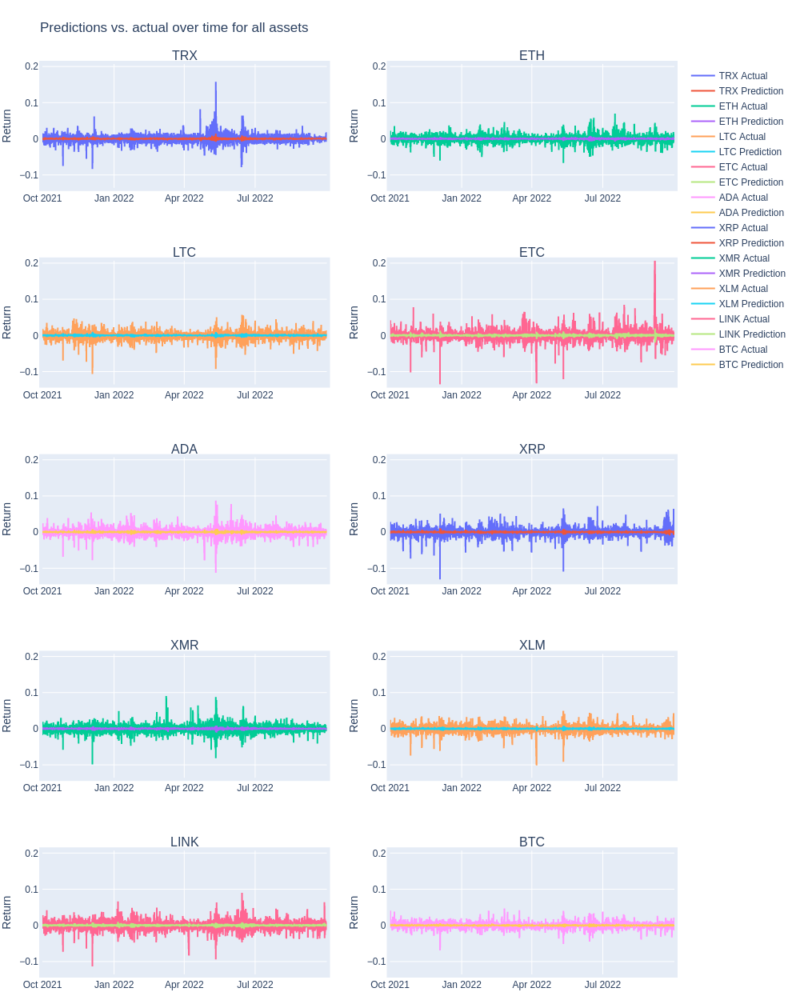

In [10]:
error_linear.predictions().show(renderer="png")

Looking at the correlation & plot of the standard deviation of the window (300 time steps before the prediction) and the error (squared for the correlation and unsquared for the plots), we can see that for assets with higher standard deviation have higher errors (e.g., ETC). Interestingly this does not really seem the case for the window standard deviation vs. error as even coins with a high correlation (e.g., XMR) do not have high total errors. Still there seems to be a relationship between standard deviation of the coin in the window and squared error (0.098). As this model is linear, this makes sense. It cannot model high standard deviation as it only is polynom of first degree. It would be expected that a model with more flexibility is able to model the standard deviation better.

-------------------- Error report --------------------
Correlation of window standard deviation and error 0.0981708162416183                     
asset               ADA         BTC         ETC         ETH        LINK  \
correlation  0.13543513  0.09020882  0.03204880  0.13183818  0.12120526   
MSE          0.00008026  0.00003743  0.00012269  0.00006173  0.00010070   
MAE          0.00607562  0.00408748  0.00700212  0.00537370  0.00700468   
mean        -0.00014064 -0.00007345  0.00000183 -0.00006210 -0.00007971   
std          0.00905281  0.00619942  0.01118492  0.00796992  0.01013135   

asset               LTC         TRX         XLM         XMR         XRP  
correlation  0.10098636  0.11711946  0.08130712  0.15143339  0.08095324  
MSE          0.00007139  0.00006504  0.00006545  0.00008261  0.00007457  
MAE          0.00569480  0.00486848  0.00571594  0.00636625  0.00562246  
mean        -0.00008453 -0.00001097 -0.00006963 -0.00002010 -0.00004157  
std          0.00853162  0.008111

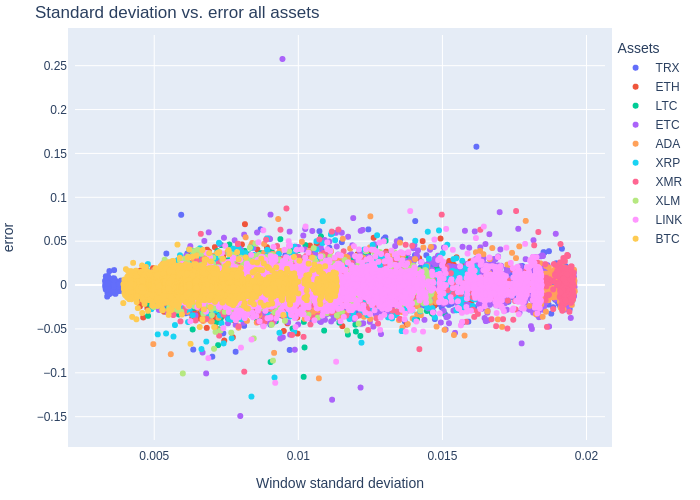

 
-------------------- Error over time per asset --------------------


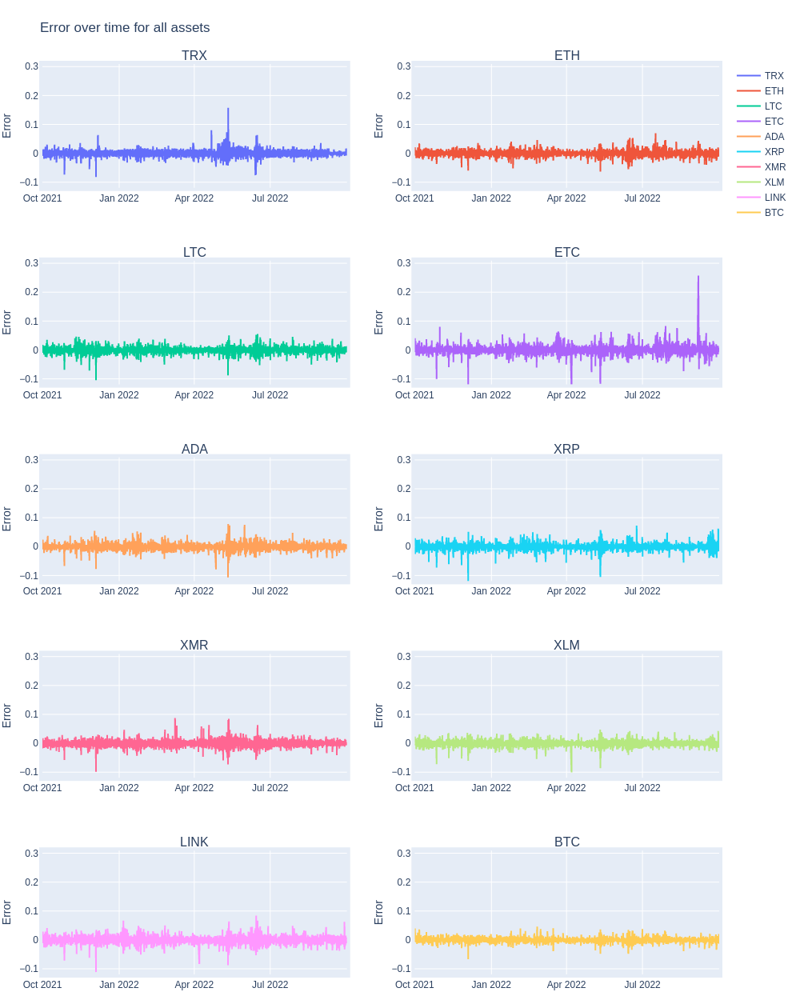

In [11]:
error_linear.report()

#### XGBoost
To capture more movement of the data with our model we use XGBoost. First we begin with a XGB regression model with the default hyperparmeters. To get more insights into why we choose XGBoost as a model, have a look at the 90_appendix notebook.
XGBoost will look at each timestep in the window and model decisions based on that. It therefore is able to pick up non-linear relationships between our window and the target variable. Therefore, we expect the model to perform better.

In [12]:
from xgboost import XGBRegressor
xgb_model, xgb_predictions, xgb_results = fp.fit_predict(XGBRegressor(), 
                                                               X_fit=X_train, y_fit=y_train,
                                                               X_validate=X_test, y_validate=y_test, 
                                                               store=results)

In [13]:
results.get_df().sort_values("mse")

,model,predictions,truth,meta,mae,mse,train_mae,train_mse
2,XGBRegressor,"[0.0011033476, -0.00040828992, 0.00034366077, ...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00576150,0.00007602,0.00674717,0.00010793
1,LinearRegression,"[0.0011566120488747395, -0.0013134641840970114...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'copy_X': True, 'fit_intercept': True, 'n_job...",0.00578076,0.00007618,0.00739078,0.00015420
0,DummyRegressor,"[0.00016026363705720398, 0.0001602636370572039...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'constant': None, 'quantile': None, 'strategy...",0.00580505,0.00007749,0.00744410,0.00015741


#### Plot XGBoost baseline results
The XGBoost model shows more variation in the predictions. XGBoost is better than linear regression, as it allows itself to not only follow the trend linearly but also model non-linear relationships in the data. This is evident by the predictions that do not center only around a certain area around the mean.

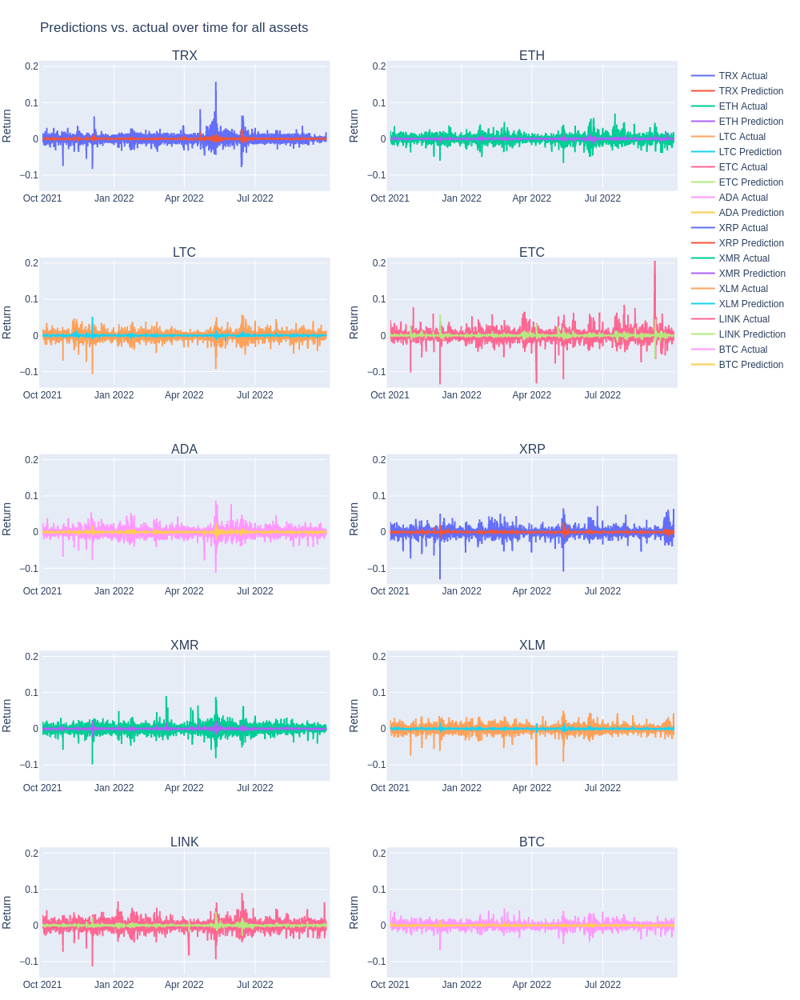

In [14]:
error_xgb = ea.ErrorAnalysis(y_true=y_test, y_pred=xgb_predictions, X=test, non_window_columns=["index", "returns", "asset"])
error_xgb.predictions().show(renderer="png")

#### Hyperparameter Optimization for XGBoost on subset of the data
Based on the model above the XGBoost model looks promising. As it has a lot of parameters, we use a hyperparameter optimization framework to improve model performance. The training dataset is very large, therefore we take a subsample of the data to do the optimization. We let it run for 20000 different combinations. Optuna is an automatic hyperparameter optimization software framework, particularly designed for machine learning. It is very similar to HyperOpt. We can also define non-discrete search spaces (i.e. instead of defining a fixed grid, we say “look at the space between a minimum and maximum”). Optuna uses a Tree-structured Parzen Estimator to suggest hyperparameter. TSP estimators sequentially construct models to approximate the performance of hyperparameters based on historical measurements, and then subsequently choose new hyperparameters to test based on this model.

In [15]:
subsample_train_x, valid_x, subsample_train_y, valid_y = train_test_split(X_train, y_train, test_size=0.5, random_state=42, shuffle=True)
subsample_train_x, subsample_valid_x, subsample_train_y, subsample_valid_y = train_test_split(subsample_train_x, subsample_train_y, test_size=0.3, random_state=42, shuffle=True)

In [16]:
import xgboost as xgb


def objective(trial):
    dtrain = xgb.DMatrix(subsample_train_x, label=subsample_train_y)
    dvalid = xgb.DMatrix(subsample_valid_x, label=subsample_valid_y)

    param = {
        "verbosity": 0,
        "objective": 'reg:squarederror',
        "eval_metric": "rmse",
        "booster": trial.suggest_categorical("booster", ["gbtree", "gblinear", "dart"]),
        "lambda": trial.suggest_float("lambda", 1e-8, 1.0, log=True),
        "alpha": trial.suggest_float("alpha", 1e-8, 1.0, log=True),
    }

    if param["booster"] == "gbtree" or param["booster"] == "dart":
        param["max_depth"] = trial.suggest_int("max_depth", 1, 9)
        param["eta"] = trial.suggest_float("eta", 1e-8, 1.0, log=True)
        param["gamma"] = trial.suggest_float("gamma", 1e-8, 1.0, log=True)
        param["grow_policy"] = trial.suggest_categorical("grow_policy", ["depthwise", "lossguide"])
    if param["booster"] == "dart":
        param["sample_type"] = trial.suggest_categorical("sample_type", ["uniform", "weighted"])
        param["normalize_type"] = trial.suggest_categorical("normalize_type", ["tree", "forest"])
        param["rate_drop"] = trial.suggest_float("rate_drop", 1e-8, 1.0, log=True)
        param["skip_drop"] = trial.suggest_float("skip_drop", 1e-8, 1.0, log=True)

    # Add a callback for pruning.
    pruning_callback = optuna.integration.XGBoostPruningCallback(trial, "validation-rmse")
    bst = xgb.train(param, dtrain, evals=[(dvalid, "validation")], callbacks=[pruning_callback], verbose_eval=False)
    preds = bst.predict(dvalid)
    mse = mean_squared_error(subsample_valid_y, preds)
    return mse



The study is setup in a way where "unpromising" trials are pruned. Optuna checks after 5 epochs of model fitting if the validation-rmse is better than the median observed RMSE of previous trials. If not, the trial will be "pruned", i.e. skipped. This allows for quicker search.

In [17]:
study = optuna.create_study(
    pruner=optuna.pruners.MedianPruner(n_warmup_steps=5), direction="minimize",
    storage="sqlite:///results/db/xgbmodel_new.db", 
    load_if_exists=True,
    study_name="xgb1"
)


In [ ]:
# we do not run this cell here as it will take hours (it was run on a seperate server)
study.optimize(objective, n_trials=20000)

##### Retrieve best XGBoost model and fit it on the entire dataset
The best parameters for on the subsample of the data are used to fit the model on the entire dataset and predict on test data.

In [18]:
study.best_params

{'alpha': 1.364364900806727e-05,
 'booster': 'gbtree',
 'eta': 0.6276484306042439,
 'gamma': 0.009358215134957949,
 'grow_policy': 'lossguide',
 'lambda': 0.00011649790703808614,
 'max_depth': 3}

In [19]:
xgb_optuna_model, xgb_optuna_predictions, xgb_optuna_results = fp.fit_predict(XGBRegressor(**study.best_params), 
                                                               X_fit=X_train, y_fit=y_train,
                                                               X_validate=X_test, y_validate=y_test, 
                                                               store=results)
error_xgb_optuna = ea.ErrorAnalysis(y_true=y_test, y_pred=xgb_optuna_predictions, X=test, non_window_columns=["index", "returns", "asset"])

In [20]:
results.get_df().sort_values("mse")

,model,predictions,truth,meta,mae,mse,train_mae,train_mse
3,XGBRegressor,"[0.0011180385, -0.0007129713, -0.00026680803, ...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00574853,0.00007566,0.00729701,0.00014180
2,XGBRegressor,"[0.0011033476, -0.00040828992, 0.00034366077, ...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00576150,0.00007602,0.00674717,0.00010793
1,LinearRegression,"[0.0011566120488747395, -0.0013134641840970114...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'copy_X': True, 'fit_intercept': True, 'n_job...",0.00578076,0.00007618,0.00739078,0.00015420
0,DummyRegressor,"[0.00016026363705720398, 0.0001602636370572039...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'constant': None, 'quantile': None, 'strategy...",0.00580505,0.00007749,0.00744410,0.00015741


The model performs very well on the test data. The MSE is distinctly better than the non-optimized XGB model. But still the results are not much better than the dummy model. One issue is still that the model does not really model the more "extreme" returns well. It predicts around the mean. This might mean that the choosen window is not right and the model is not able to detect relationships within the 300 hour window.   
This might have something todo with how XGBoost splits the trees and therefore is not able to model all the relationships between timesteps in the window. Therefore a fully connected neural net might do a better job at modelling those complex relationships.

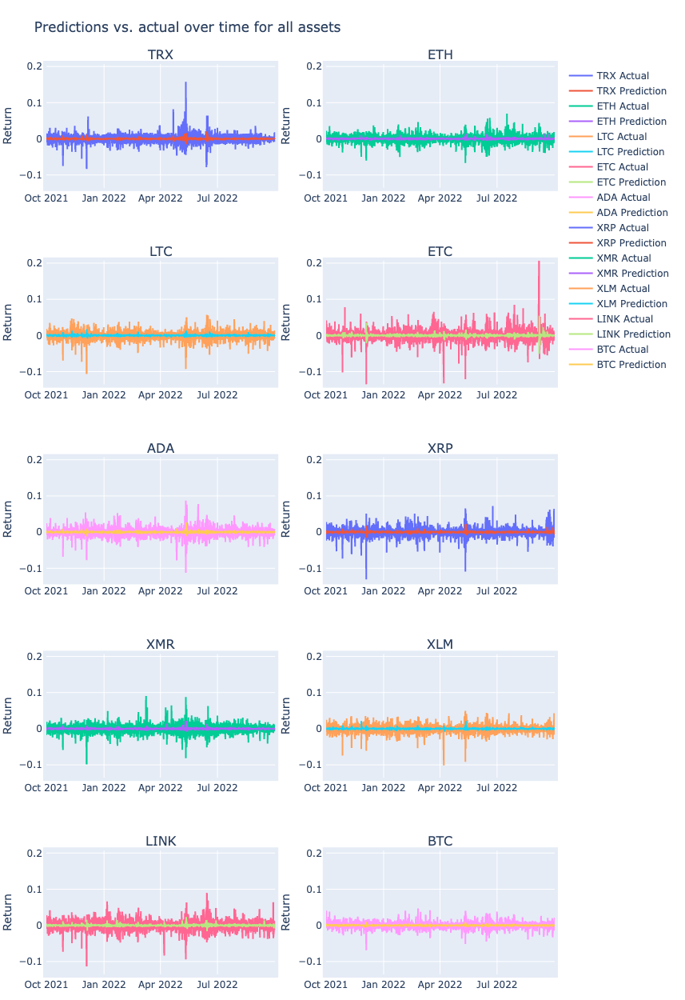

In [21]:
error_xgb_optuna.predictions()

Suprisingly the models correlation between the error and standard deviation increases compared to linear regression (0.099 vs 0.098). This is inline with the plots above where we visually can see that the model does not react to more volatile returns. Even though the model performs better overall, the tendency of the results are still the same - assets with higher volatility are harder to model than ones with lower. The increased model complexity does not significantly change that behaivor.

-------------------- Error report --------------------
Correlation of window standard deviation and error 0.09969260098128274                     
asset               ADA         BTC         ETC         ETH        LINK  \
correlation  0.13570744  0.08944860  0.03435978  0.12974694  0.12063718   
MSE          0.00008000  0.00003714  0.00012323  0.00006120  0.00009972   
MAE          0.00605918  0.00407083  0.00700308  0.00535301  0.00697032   
mean        -0.00014064 -0.00007345  0.00000183 -0.00006210 -0.00007971   
std          0.00905281  0.00619942  0.01118492  0.00796992  0.01013135   

asset               LTC         TRX         XLM         XMR         XRP  
correlation  0.09924492  0.12910670  0.07869428  0.15522820  0.07988965  
MSE          0.00007048  0.00006484  0.00006395  0.00008251  0.00007356  
MAE          0.00566001  0.00478480  0.00564371  0.00635329  0.00559012  
mean        -0.00008453 -0.00001097 -0.00006963 -0.00002010 -0.00004157  
std          0.00853162  0.00811

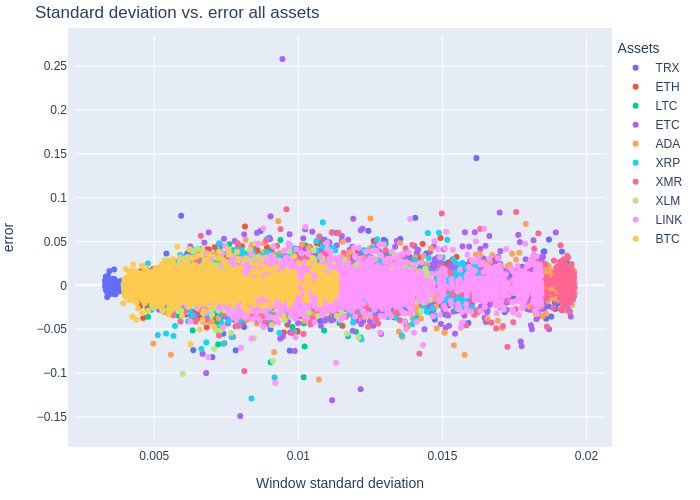

 
-------------------- Error over time per asset --------------------


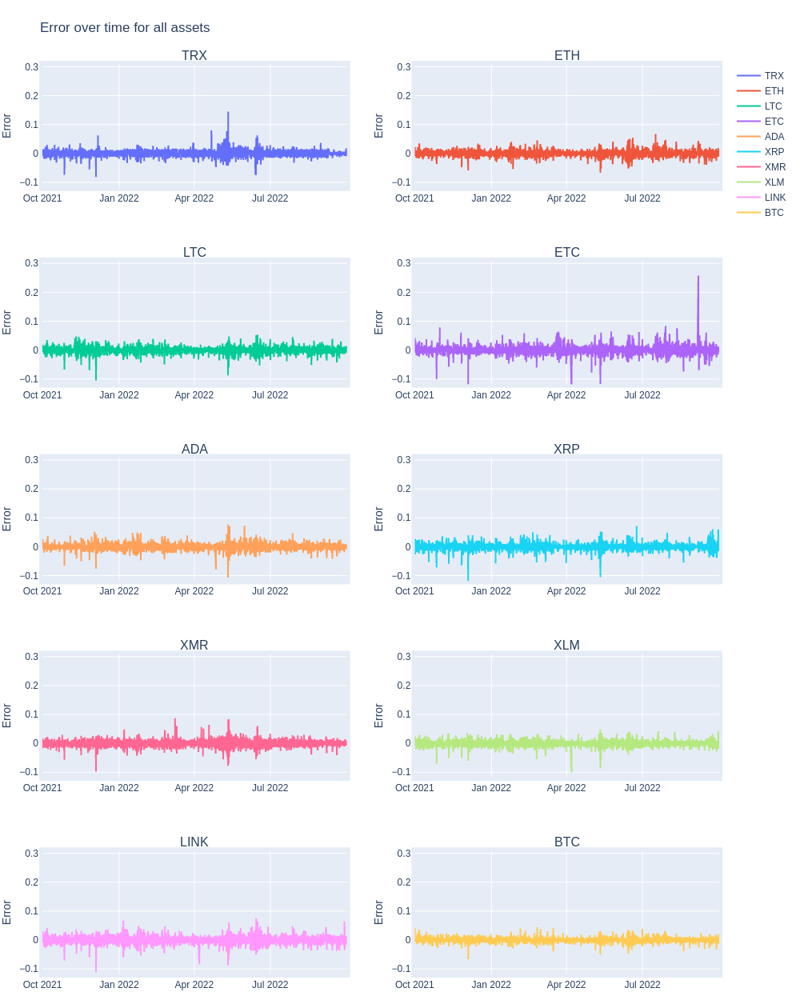

In [22]:
error_xgb_optuna.report()

In [23]:
# save current results for futher modelling
results.save(path="results")